# Analysis of cancer data (Thienpont_2018) mapped onto the HLCA

import modules:

In [1]:
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import sys
import pandas as pd
import numpy as np
import os

sys.path.append("../../scripts/")
import nested_clustering

set figure params:

In [2]:
sc.set_figure_params(figsize=(8, 8))

for pretty code formatting (not needed):

In [3]:
%load_ext lab_black

set paths:

In [4]:
path_thienpont_data = "../../data/HLCA_extended/HLCA_core_plus_single_study/HLCA_thienpont_2018_adata_full_tcnorm_log1p.h5ad"
path_label_transfer = (
    "../../results/HLCA_ext_label_transfer/transfered_labels_query_only.csv"
)
path_celltype_info = "../../supporting_files/celltype_structure_and_colors/manual_anns_and_leveled_anns_ordered.csv"
dir_figures = "../../results/figures/"

load data:

In [5]:
adata = sc.read_h5ad(path_thienpont_data)

In [6]:
label_tr_res = pd.read_csv(path_label_transfer, index_col=0)

In [7]:
ct_df = pd.read_csv(path_celltype_info, index_col=0)

create empty dictionary to store paper figures in:

In [8]:
FIGURES = dict()

check if the label transfer results have transfered labels for all Thienpont cells:

In [9]:
thienpont_cells = adata.obs.loc[adata.obs.study == "Thienpont_2018", :].index.tolist()
label_tr_res.index.isin(adata.obs.index).sum() == len(thienpont_cells)

True

add label transfer results to adata:

In [10]:
for col in label_tr_res.columns:
    adata.obs[col] = np.nan
    adata.obs.loc[thienpont_cells, col] = label_tr_res.loc[thienpont_cells, col]

Store annotations from cancer data in a separate column:

In [11]:
adata.obs["manual_ann_query_only"] = None
adata.obs.loc[
    adata.obs.study == "Thienpont_2018", "manual_ann_query_only"
] = adata.obs.loc[adata.obs.study == "Thienpont_2018", "original_celltype_ann"]

Plot some umaps:

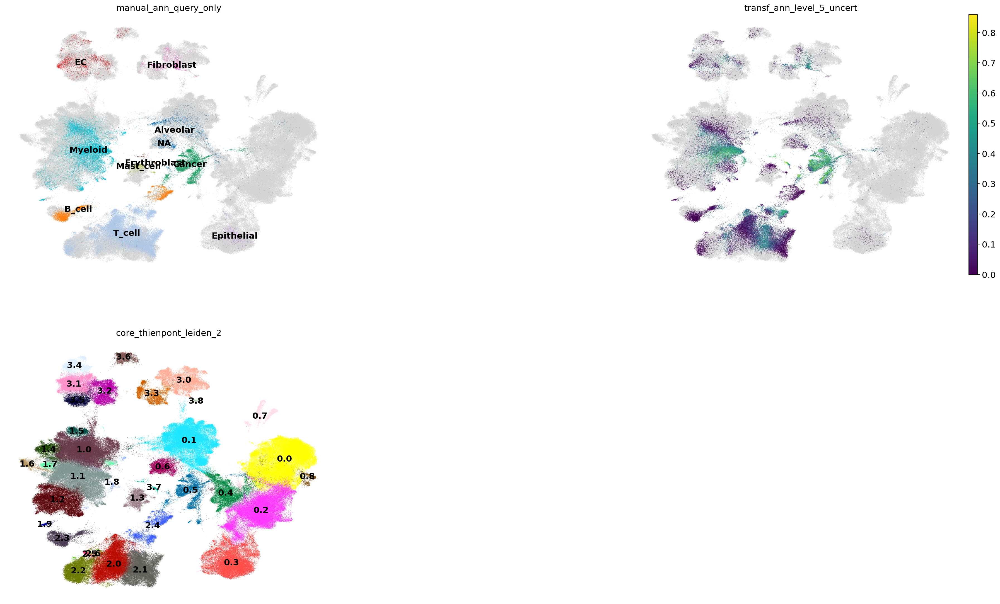

In [12]:
sc.pl.umap(
    adata,
    color=[
        "manual_ann_query_only",
        "transf_ann_level_5_uncert",
        "core_thienpont_leiden_2",
    ],
    ncols=2,
    wspace=0.75,
    size=1,
    legend_loc="on data",
    frameon=False,
)

In [13]:
subject_to_cancertype = {
    "lambrechts_1": "Squamous Cell Carcinoma",
    "lambrechts_2": "Squamous Cell Carcinoma",
    "lambrechts_3": "Adenocarcinoma",
    "lambrechts_4": "Adenocarcinoma",
    "lambrechts_5": "Large Cell Carcinoma",
    "lambrechts_6": "Adenocarcinoma",
    "lambrechts_7": "Squamous Cell Carcinoma",
    "lambrechts_8": "Pleiomorphic Carcinoma",
}
subject_to_thienpont_subject = {tsubj: tsubj for tsubj in subject_to_cancertype.keys()}
site_acr_to_site = {
    "I": "Tumor (inner)",
    "M": "Tumor (middle)",
    "O": "Tumor (outer)",
    "U": "Unknown",
    "N": "Normal",
}

In [14]:
adata.obs["thienpont_cancer_type"] = adata.obs.subject_ID.map(subject_to_cancertype)
adata.obs["thienpont_subject_ID"] = adata.obs.subject_ID.map(
    subject_to_thienpont_subject
)
adata.obs["tumor_site_long"] = adata.obs["tumor_site"].map(site_acr_to_site)

In [15]:
hlca_cells = adata.obs.index[adata.obs.study != "Thienpont_2018"].tolist()
adata_thienpont_first = adata[hlca_cells + thienpont_cells, :].copy()

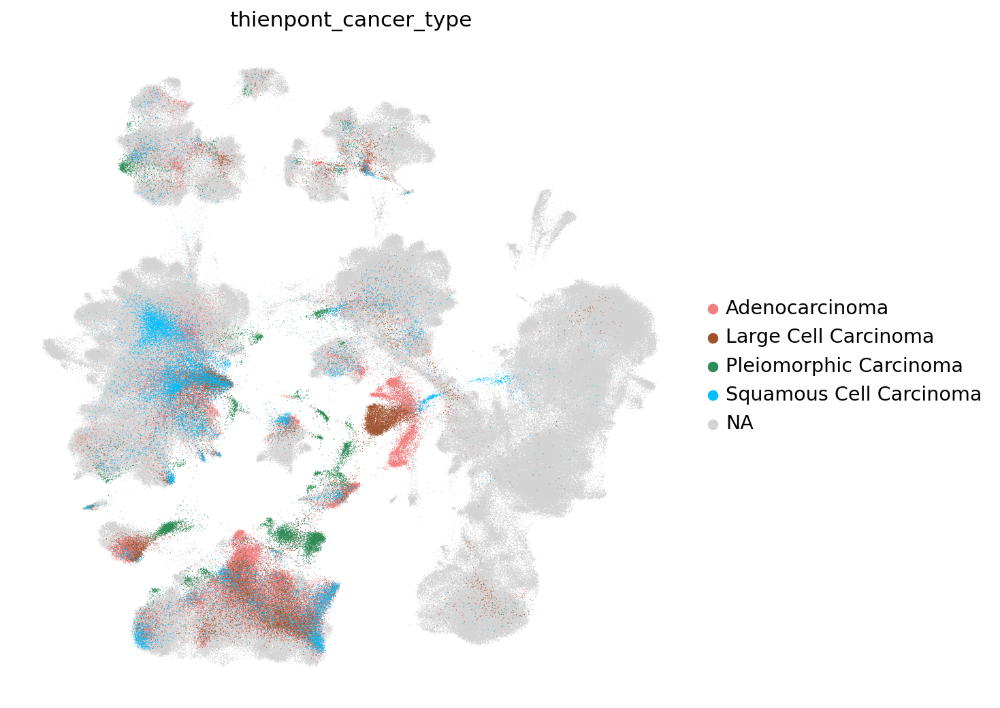

In [16]:
cancer_type_colors = {
    "Adenocarcinoma": "lightcoral",
    "Large Cell Carcinoma": "sienna",
    "Pleiomorphic Carcinoma": "seagreen",
    "Squamous Cell Carcinoma": "deepskyblue",
    "nan": "lightgrey",
}
FIGURES["ED_thienpont_cancer_type"] = sc.pl.umap(
    adata_thienpont_first,
    color=["thienpont_cancer_type"],
    ncols=2,
    wspace=0.75,
    s=1,
    frameon=False,
    return_fig=True,
    palette=cancer_type_colors,
)

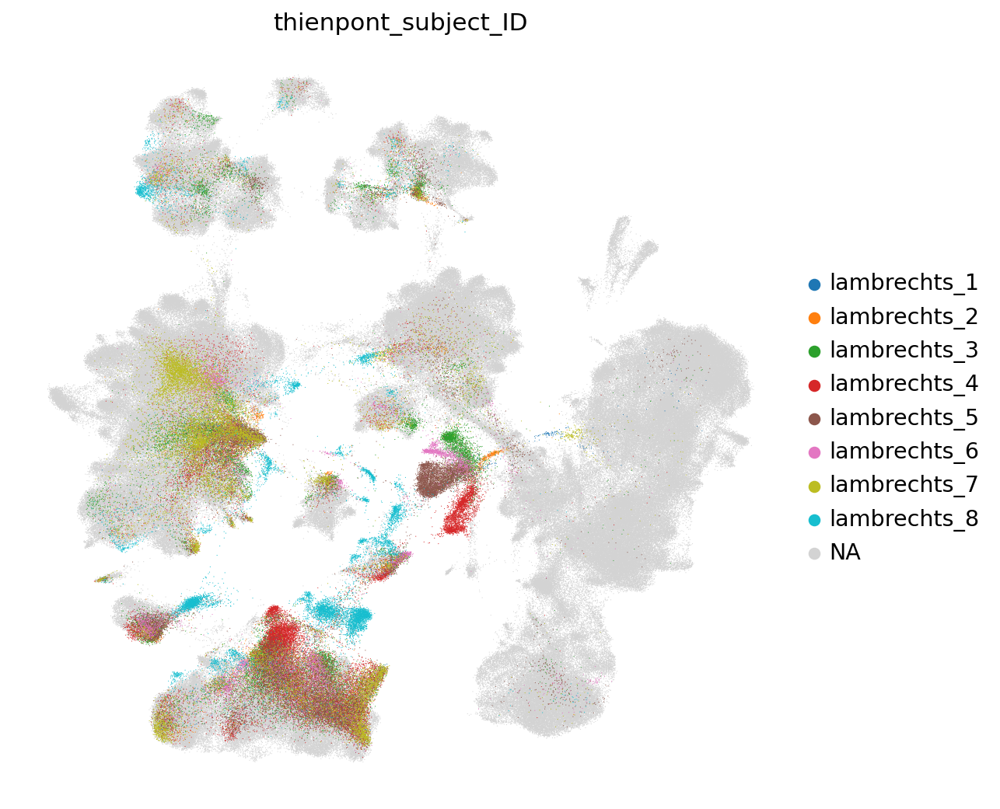

In [17]:
subject_to_color = {
    "lambrechts_1": "tab:blue",
    "lambrechts_2": "tab:orange",
    "lambrechts_3": "tab:green",
    "lambrechts_4": "tab:red",
    "lambrechts_5": "tab:brown",
    "lambrechts_6": "tab:pink",
    "lambrechts_7": "tab:olive",
    "lambrechts_8": "tab:cyan",
    "nan": "lightgrey",
}
FIGURES["ED_thienpont_subject_ID"] = sc.pl.umap(
    adata_thienpont_first,
    color=["thienpont_subject_ID"],
    ncols=2,
    wspace=0.75,
    s=1,
    frameon=False,
    return_fig=True,
    palette=subject_to_color,
)

In [18]:
adata_thienpont_first.obs.loc[
    adata_thienpont_first.obs.manual_ann_grouped == "nan", "manual_ann_grouped"
] = np.nan

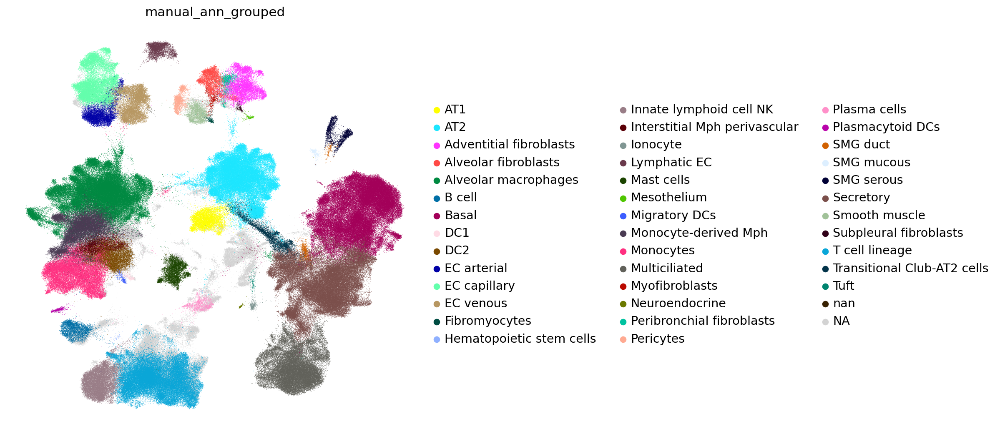

In [19]:
FIGURES["ED_thienpont_ref_annotations_coarse_umap"] = sc.pl.umap(
    adata_thienpont_first,
    color=["manual_ann_grouped"],
    ncols=2,
    wspace=0.75,
    s=1,
    frameon=False,
    return_fig=True,
    na_color="lightgrey",
)

acronym explanation lambrechts: I = inner tumor part ( called “core" in the 2018 paper) ; M = middle tumor part and O = outer tumor part ( called "edge" in the 2018 paper), U is undefined tumor part, cells with “N", are cells from normal tissue.

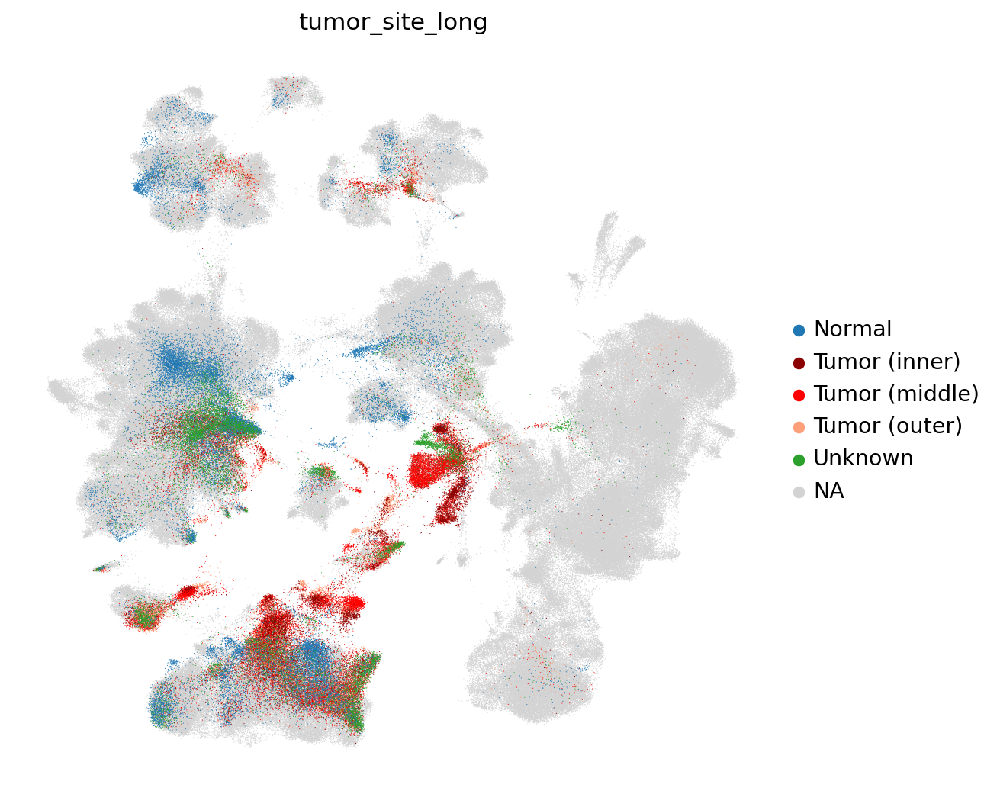

In [20]:
tumor_site_to_color = {
    "Normal": "tab:blue",
    "Tumor (inner)": "darkred",
    "Tumor (middle)": "red",
    "Tumor (outer)": "lightsalmon",
    "Unknown": "tab:green",
    "nan": "lightgrey",
}
sc.pl.umap(
    adata_thienpont_first,
    color=["tumor_site_long"],
    ncols=2,
    wspace=0.75,
    s=1,
    frameon=False,
    palette=tumor_site_to_color,
)

# CANCER CELL ANALYSIS:

(Not included in paper)

calculate percentage of cancer cells per cluster to identify cancer cluster:

In [21]:
cancer_perc_per_cluster = (
    adata.obs.groupby(["manual_ann_query_only", "core_thienpont_leiden_2"])
    .agg({"core_thienpont_leiden_2": "count"})
    .unstack()
).loc["Cancer", :]
cancer_perc_per_cluster = (
    cancer_perc_per_cluster / cancer_perc_per_cluster.sum() * 100
).sort_values(ascending=False)

In [22]:
cancer_perc_per_cluster.head(5)

                         core_thienpont_leiden_2
core_thienpont_leiden_2  0.5                        94.574399
                         0.0                         1.242690
                         2.0                         0.706628
                         2.4                         0.666017
                         0.1                         0.657895
Name: Cancer, dtype: float64

subset to cancer cluster:

In [23]:
canc_adata = adata[adata.obs.core_thienpont_leiden_2 == "0.5", :].copy()

In [24]:
sc.pp.neighbors(canc_adata, n_neighbors=30, use_rep="X_scanvi_emb")
sc.tl.umap(canc_adata)

/home/icb/lisa.sikkema/miniconda3/envs/HLCA_basic/lib/python3.7/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


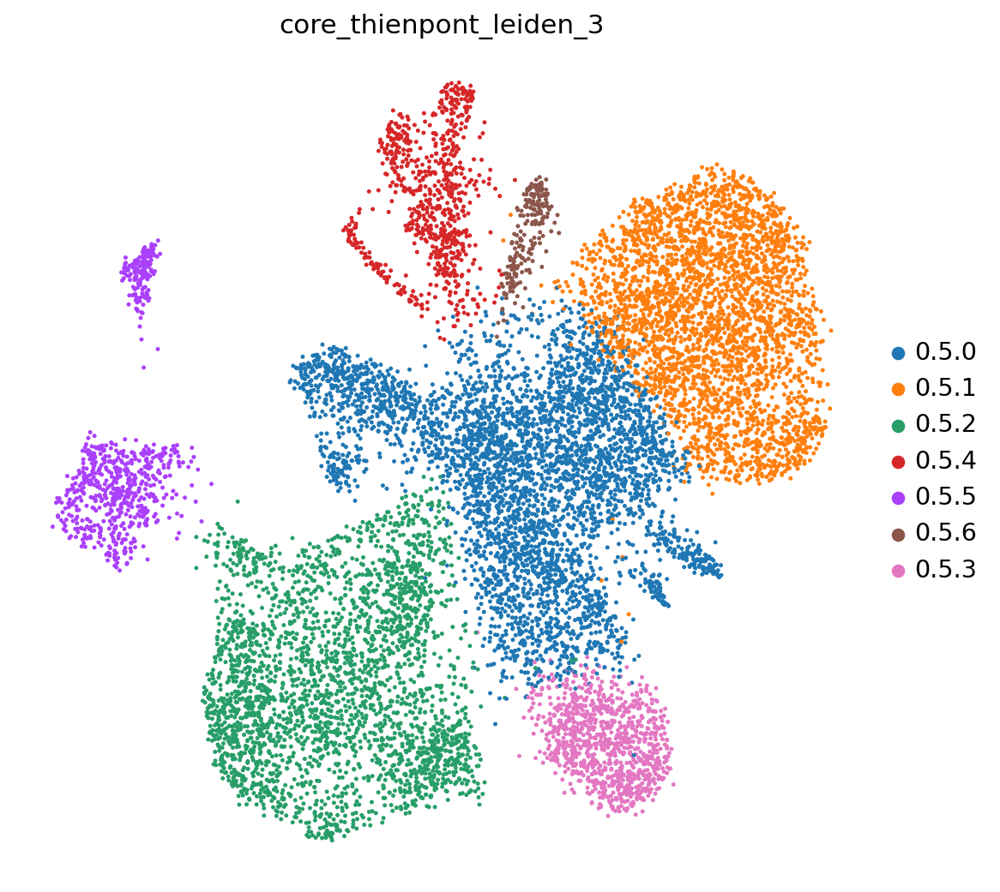

In [25]:
del canc_adata.uns["core_thienpont_leiden_3_colors"]
sc.pl.umap(
    canc_adata,
    color=["core_thienpont_leiden_3"],
    ncols=2,
    wspace=0.75,
    s=20,
    frameon=False,
)

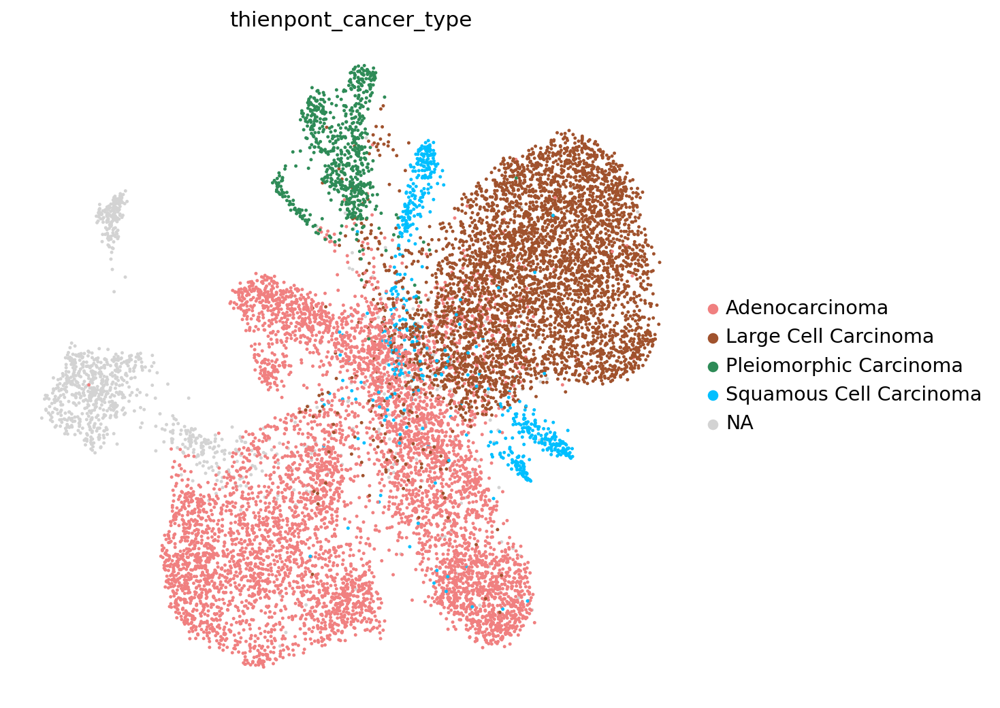

In [26]:
cancer_type_colors = {
    "Adenocarcinoma": "lightcoral",
    "Large Cell Carcinoma": "sienna",
    "Pleiomorphic Carcinoma": "seagreen",
    "Squamous Cell Carcinoma": "deepskyblue",
    "nan": "lightgrey",
}
sc.pl.umap(
    canc_adata,
    color=["thienpont_cancer_type"],
    ncols=2,
    wspace=0.75,
    s=20,
    frameon=False,
    palette=cancer_type_colors,
)

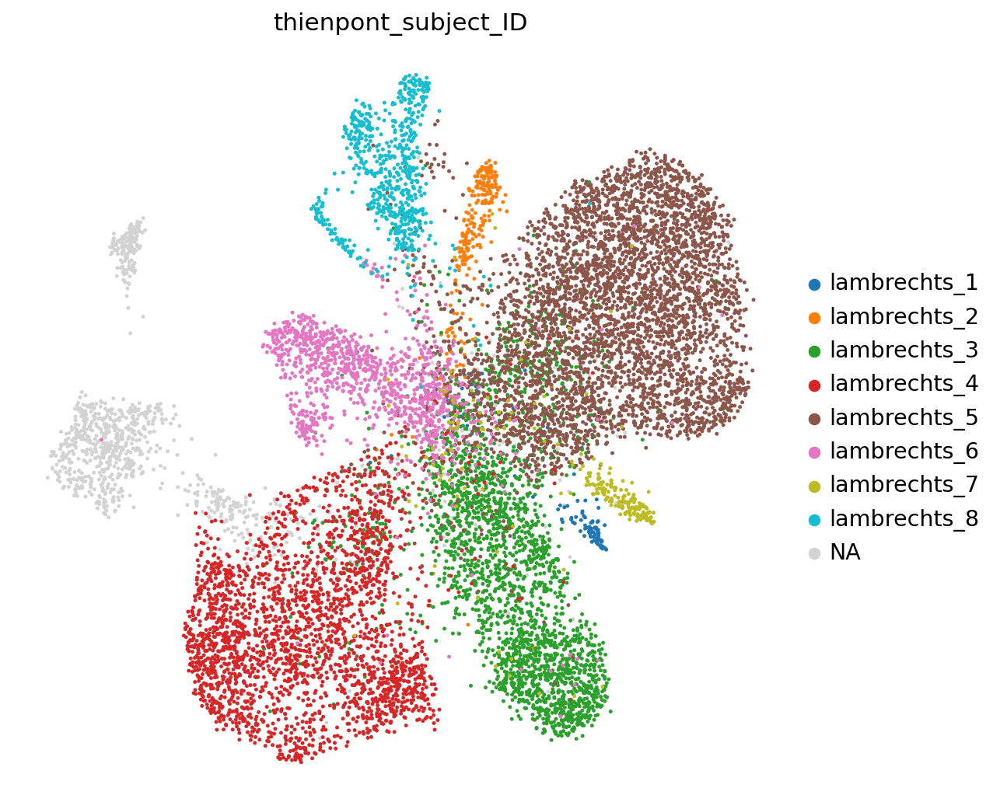

In [27]:
subject_to_color = {
    "lambrechts_1": "tab:blue",
    "lambrechts_2": "tab:orange",
    "lambrechts_3": "tab:green",
    "lambrechts_4": "tab:red",
    "lambrechts_5": "tab:brown",
    "lambrechts_6": "tab:pink",
    "lambrechts_7": "tab:olive",
    "lambrechts_8": "tab:cyan",
    "nan": "lightgrey",
}
sc.pl.umap(
    canc_adata,
    color=["thienpont_subject_ID"],
    ncols=2,
    wspace=0.75,
    s=20,
    frameon=False,
    palette=subject_to_color,
)

# ENDOTHELIAL CELL ANALYSIS:

select endothelial cell clusters (non-lymphatic) and re-embed:

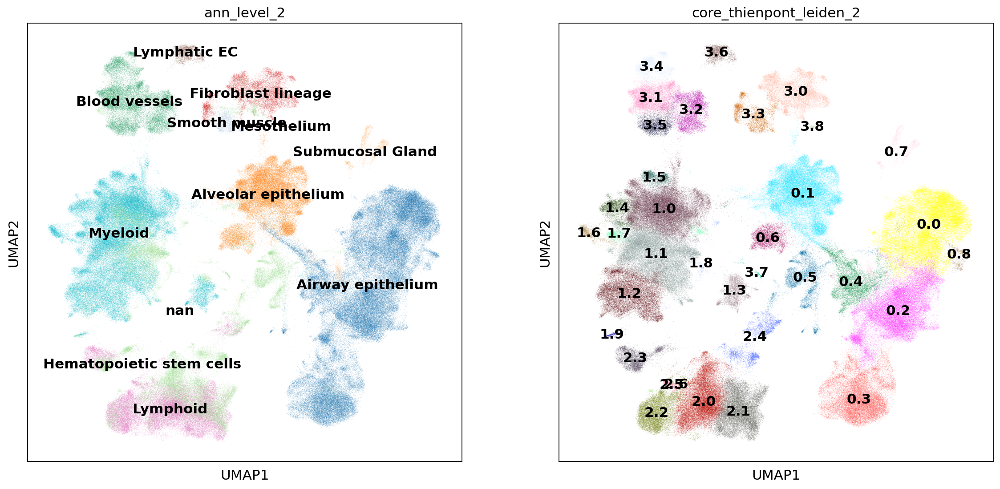

In [28]:
sc.pl.umap(
    adata, color=["ann_level_2", "core_thienpont_leiden_2"], legend_loc="on data"
)

In [29]:
end_clusters = ["3.1", "3.2", "3.4", "3.5"]

In [30]:
subadata = adata[adata.obs.core_thienpont_leiden_2.isin(end_clusters), :].copy()

In [31]:
subadata.shape

(47037, 29541)

In [32]:
sc.pp.neighbors(subadata, n_neighbors=30, use_rep="X_scanvi_emb")
sc.tl.umap(subadata)

add EC clustering:

In [33]:
sc.tl.leiden(subadata, resolution=0.5, key_added="EC_clusters")

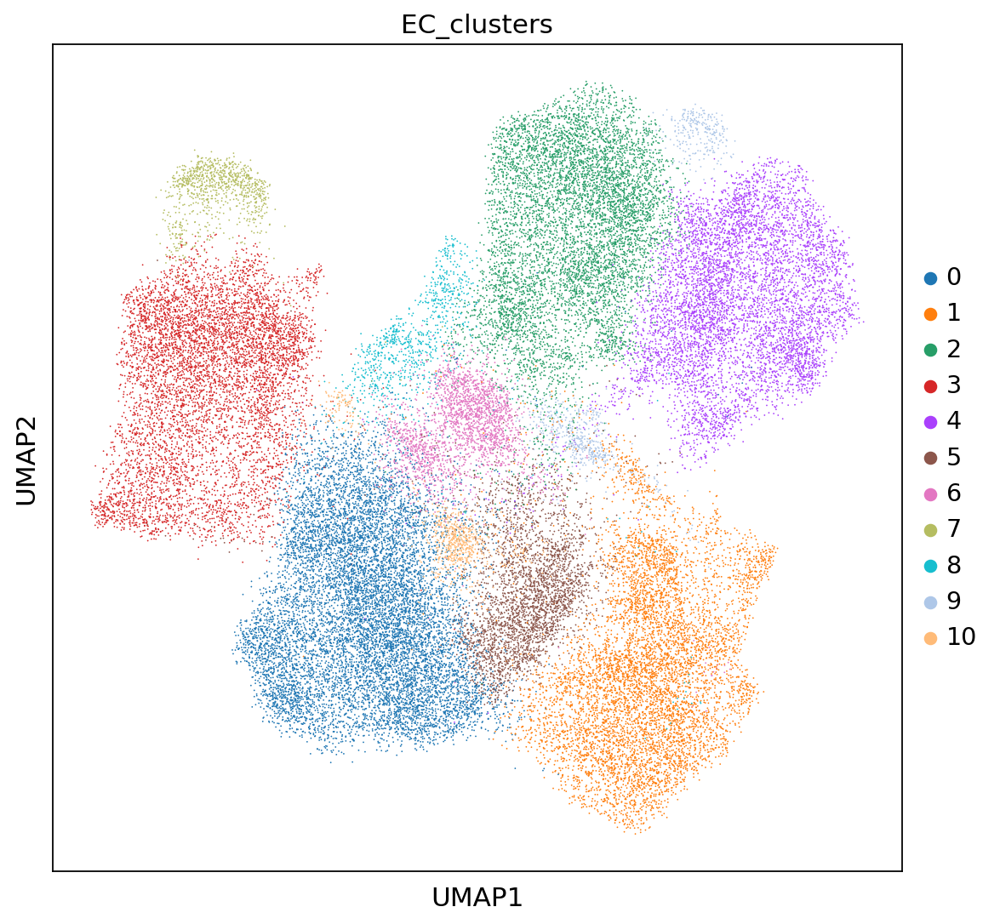

In [34]:
sc.pl.umap(subadata, color="EC_clusters")

add a 4th layer of clustering:

In [35]:
# k = 10
# min_cluster_size = 10
# cluster_res = 0.2
# subadata = nested_clustering.add_nested_clustering_blind(
#     subadata,
#     cluster_label_previous="core_thienpont_leiden_3",
#     cluster_label_new="core_thienpont_leiden_4",
#     use_rep="X_scarches_emb",
#     cluster_alg="leiden",
#     cluster_k=k,
#     cluster_res=cluster_res,
#     min_cluster_size=min_cluster_size,
#     redo_pca=False,  # SET THIS TO FALSE FOR SCANVI!!! OR OTHER EMBEDDING-OUTPUT METHODS!!!!!
# )

In [36]:
# subadata.obs.core_thienpont_leiden_3.cat.reorder_categories(
#     new_categories=sorted(subadata.obs.core_thienpont_leiden_3.unique()), inplace=True
# )

In [37]:
# del subadata.uns["core_thienpont_leiden_3_colors"]

In [38]:
# sc.set_figure_params(figsize=(5, 5))

In [39]:
# sc.pl.umap(
#     subadata,
#     color=["core_thienpont_leiden_2", "core_thienpont_leiden_3", "core_thienpont_leiden_4"],
#     ncols=2,
#     wspace=0.75,
#     s=10,
#     #     legend_loc="on data",
# )

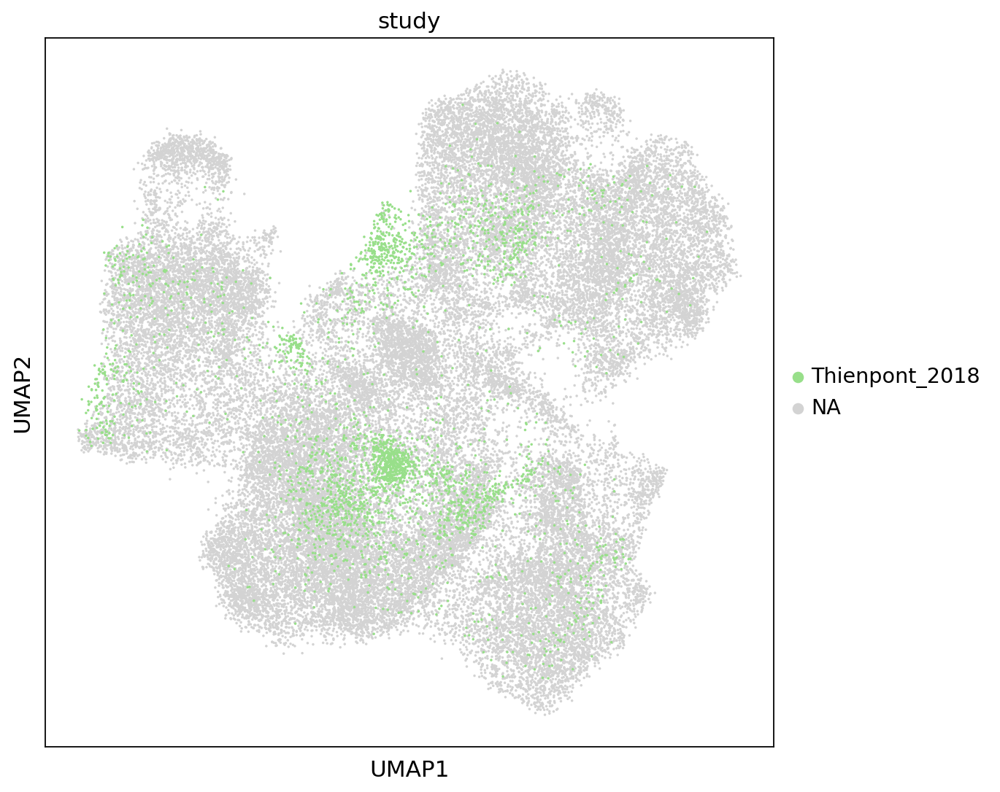

In [40]:
sc.pl.umap(subadata, color="study", groups="Thienpont_2018", s=10)

add annotations specifying if cell came from patient with lung cancer:

In [41]:
study2cancer = {
    "Banovich_Kropski_2020": "Healthy",
    "Barbry_Leroy_2020": "Healthy",
    "Jain_Misharin_2021": "Healthy",
    "Krasnow_2020": "Healthy (tumor-adjacent), Krasnow",
    "Lafyatis_Rojas_2019": "Healthy",
    "Meyer_2019": "Healthy",
    "Misharin_2021": "Healthy",
    "Misharin_Budinger_2018": "Healthy",
    "Nawijn_2021": "Healthy",
    "Seibold_2020": "Healthy",
    "Teichmann_Meyer_2019": "Healthy",
    "Thienpont_2018": None,
}

In [42]:
subadata.obs["cancer"] = subadata.obs.study.map(study2cancer)
thienpont_normal = [
    c
    for c, t, s in zip(
        subadata.obs.index, subadata.obs.cell_from_tumor, subadata.obs.study
    )
    if (t == "False" and s == "Thienpont_2018")
]
thienpont_tumor = [
    c
    for c, t, s in zip(
        subadata.obs.index, subadata.obs.cell_from_tumor, subadata.obs.study
    )
    if (t == "True" and s == "Thienpont_2018")
]
thienpont_na = [
    c
    for c, t, s in zip(
        subadata.obs.index, subadata.obs.cell_from_tumor, subadata.obs.study
    )
    if (t == "nan" and s == "Thienpont_2018")
]
subadata.obs.loc[thienpont_normal, "cancer"] = "Healthy (tumor-adjacent), Thienpont"
subadata.obs.loc[thienpont_tumor, "cancer"] = "Tumor"
subadata.obs.loc[thienpont_na, "cancer"] = "NA (cancer), Thienpont"

In [43]:
subadata.obs.cancer = pd.Categorical(
    subadata.obs.cancer,
    categories=[
        "Healthy",
        "Healthy (tumor-adjacent), Thienpont",
        "Healthy (tumor-adjacent), Krasnow",
        "Tumor",
    ],
)

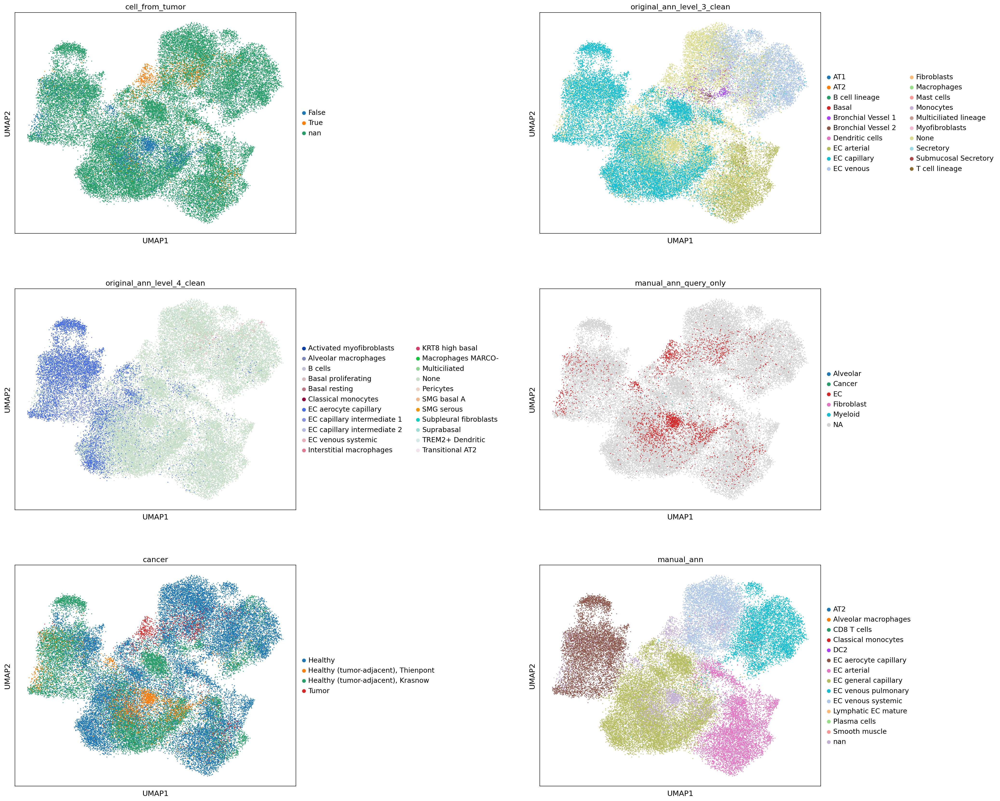

In [44]:
sc.pl.umap(
    subadata,
    color=[
        "cell_from_tumor",
        "original_ann_level_3_clean",
        "original_ann_level_4_clean",
        "manual_ann_query_only",
        "cancer",
        "manual_ann",
    ],
    s=10,
    wspace=0.7,
    ncols=2,
)

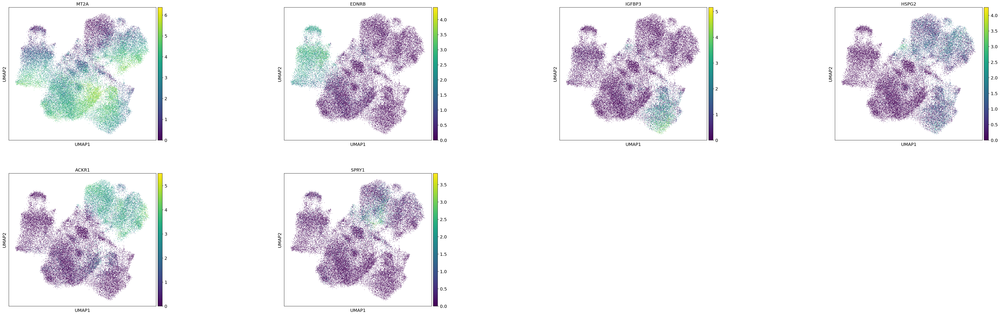

In [45]:
sc.pl.umap(
    subadata,
    color=["MT2A", "EDNRB", "IGFBP3", "HSPG2", "ACKR1", "SPRY1"],
    s=5,
    wspace=0.7,
    ncols=4,
)

plot cancer vs no cancer proportions per leiden cluster:

In [46]:
subadata.obs.cancer.unique()

['Healthy (tumor-adjacent), Krasnow', 'Healthy', 'Tumor', 'Healthy (tumor-adjacent), Thienpont']
Categories (4, object): ['Healthy', 'Healthy (tumor-adjacent), Thienpont', 'Healthy (tumor-adjacent), Krasnow', 'Tumor']

In [47]:
# COLORMAP
colors = {
    "Healthy": "yellowgreen",
    "Healthy (tumor-adjacent), Krasnow": "lightseagreen",
    "Tumor": "firebrick",
    "Healthy (tumor-adjacent), Thienpont": "dodgerblue",
}
#     "cancer (normal tissue), Krasnow": "lightseagreen",
#     "cancer (normal tissue), Thienpont": "dodgerblue",
#     "cancer (tumor tissue), Thienpont": "orchid",
#     "Healthy": "lime",
# }

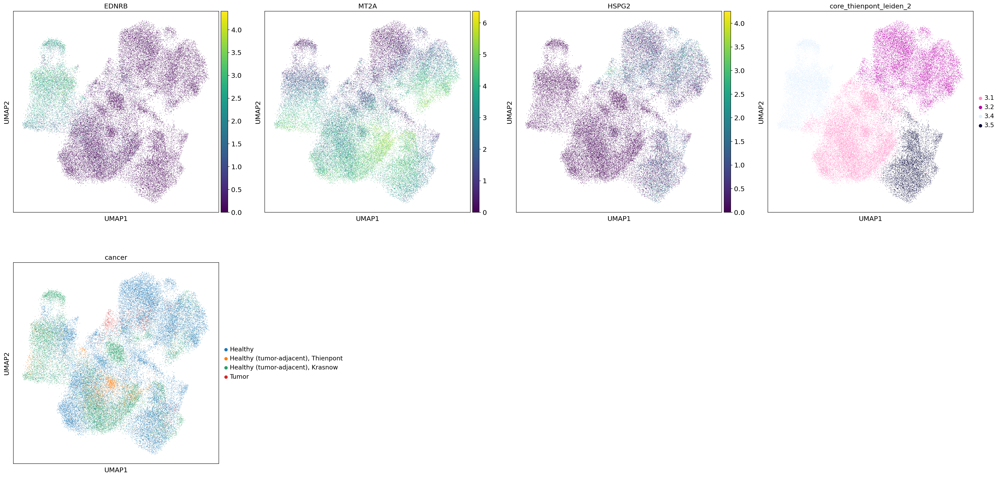

In [48]:
sc.pl.umap(
    subadata, color=["EDNRB", "MT2A", "HSPG2", "core_thienpont_leiden_2", "cancer"]
)

In [49]:
sns.set_style("white")
sns.set_context("paper")

In [50]:
manann2color = dict(zip(ct_df.index, ct_df.colors))
manann2color["Other/NA"] = "#959595"

In [51]:
manual_ann_vc = subadata.obs.manual_ann.value_counts()
ct2filtct = {ct: ct for ct in subadata.obs.manual_ann.unique()}
for ct in manual_ann_vc.index:
    if manual_ann_vc[ct] < 50:
        ct2filtct[ct] = "Other/NA"
ct2filtct["nan"] = "Other/NA"
subadata.obs["manual_ann_filt"] = subadata.obs.manual_ann.map(ct2filtct)

In [52]:
cl_manual_ann = pd.crosstab(subadata.obs.EC_clusters, subadata.obs.manual_ann_filt)

In [53]:
# show percentages of annotations per cluster
cl_manual_ann.divide(cl_manual_ann.sum(axis=1), axis=0) * 100

manual_ann_filt,EC aerocyte capillary,EC arterial,EC general capillary,EC venous pulmonary,EC venous systemic,Other/NA
EC_clusters,,,,,,
0,0.127273,0.054545,93.081818,0.045455,0.009091,6.681818
1,0.000000,94.435100,1.163443,0.028035,0.140174,4.233249
2,0.014067,0.168800,1.716134,0.815867,90.673794,6.611338
3,93.663787,0.000000,0.848871,0.000000,0.000000,5.487343
4,0.079453,0.000000,0.508502,96.345145,0.206579,2.860321
5,0.707475,1.476469,83.266687,0.645955,2.060904,11.842510
6,0.042863,3.600514,95.799400,0.171453,0.128590,0.257180
7,99.464094,0.000000,0.000000,0.000000,0.000000,0.535906
8,0.337079,1.011236,56.853933,0.449438,1.573034,39.775281


In [54]:
# improve these annotations once detailed annotations are ready
clusters_to_keep_mapper = {
    "0": "EC general capillary (I)",
    "1": "EC arterial (I)",
    "2": "EC venous systemic",
    "3": "EC aerocyte capillary (I)",
    "4": "EC venous pulmonary",
    "5": "EC general capillary (II)",
    "6": "EC general capillary (III)",
    "7": "EC aerocyte capillary (II)",
    "8": "EC general capillary (IV)",
    "9": "EC arterial (II)",
    "10": "Other/NA",
}

In [55]:
cl_manual_ann.index = cl_manual_ann.index.map(clusters_to_keep_mapper)

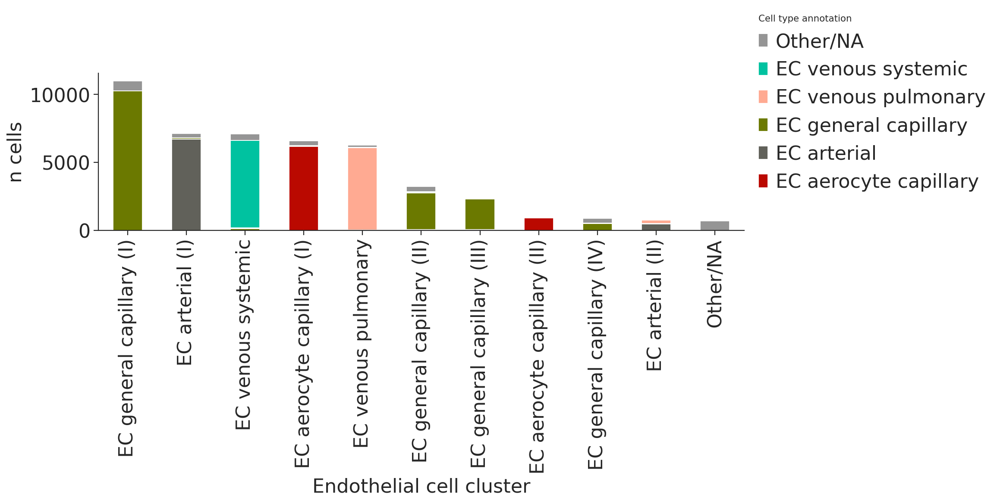

In [56]:
fz = 20
with plt.rc_context(
    {
        "figure.figsize": (12, 3),
        "xtick.labelsize": fz,
        "ytick.labelsize": fz,
        "axes.labelsize": fz,
        "font.size": fz,
        "axes.spines.right": False,
        "axes.spines.top": False,
    }
):
    fig, ax = plt.subplots()
    cl_manual_ann.plot(
        kind="bar",
        stacked=True,
        grid=False,
        color=[
            manann2color[ct] for ct in sorted(subadata.obs.manual_ann_filt.unique())
        ],
        ax=ax,
    )
    ax.tick_params(bottom=True, left=True)
    handles, labels = ax.get_legend_handles_labels()
    leg = ax.legend(
        handles[::-1],
        labels[::-1],
        loc=(1.01, 0.2),
        fontsize=fz,
        frameon=False,
        title="Cell type annotation",
    )
    leg._legend_box.align = "left"
    plt.ylabel("n cells")
    plt.xlabel("Endothelial cell cluster")
    plt.xticks(rotation=90, visible=True)
    plt.show()
    plt.close()
    FIGURES["ED_EC_cluster_manual_annotation"] = fig

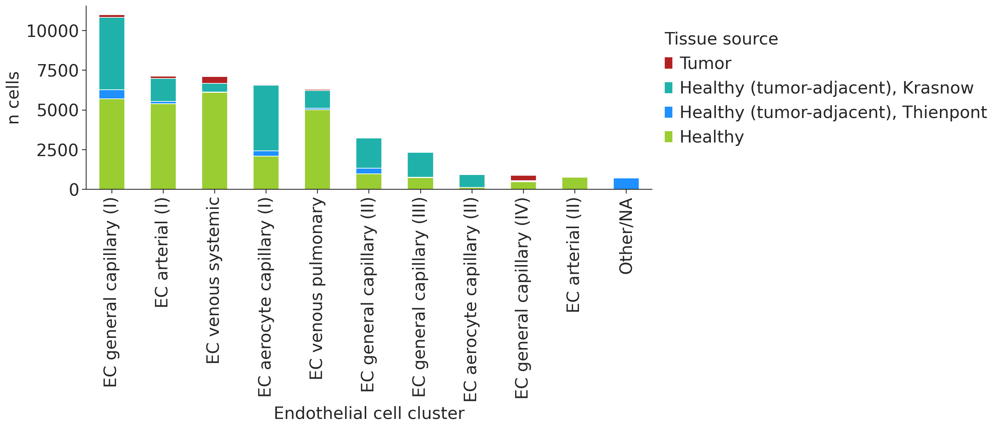

In [57]:
cl_cancer = pd.crosstab(subadata.obs.EC_clusters, subadata.obs.cancer)
cl_cancer.index = cl_cancer.index.map(clusters_to_keep_mapper)
# l3_cancer = l3_cancer.div(l3_cancer.sum(axis=1), axis=0)
fz = 20
with plt.rc_context(
    {
        "figure.figsize": (12, 4),
        "xtick.labelsize": fz,
        "ytick.labelsize": fz,
        "axes.labelsize": fz,
        "font.size": fz,
        "axes.spines.right": False,
        "axes.spines.top": False,
    }
):
    fig, ax = plt.subplots()
    cl_cancer.plot(
        kind="bar",
        stacked=True,
        grid=False,
        color=[colors[ttype] for ttype in cl_cancer.columns],
        ax=ax,
        edgecolor="white",  # "black",
    )
    ax.tick_params(bottom=True, left=True)
    handles, labels = ax.get_legend_handles_labels()
    leg = ax.legend(
        handles[::-1],
        labels[::-1],
        loc=(1.01, 0.2),
        fontsize=fz,
        frameon=False,
        title="Tissue source",
    )
    leg._legend_box.align = "left"
    leg.get_title().set_fontsize(fz)
    plt.ylabel("n cells")
    plt.xlabel("Endothelial cell cluster")
    plt.xticks(rotation=90)
    plt.show()
    plt.close()
    FIGURES["ED_EC_tissue_source_cancer"] = fig

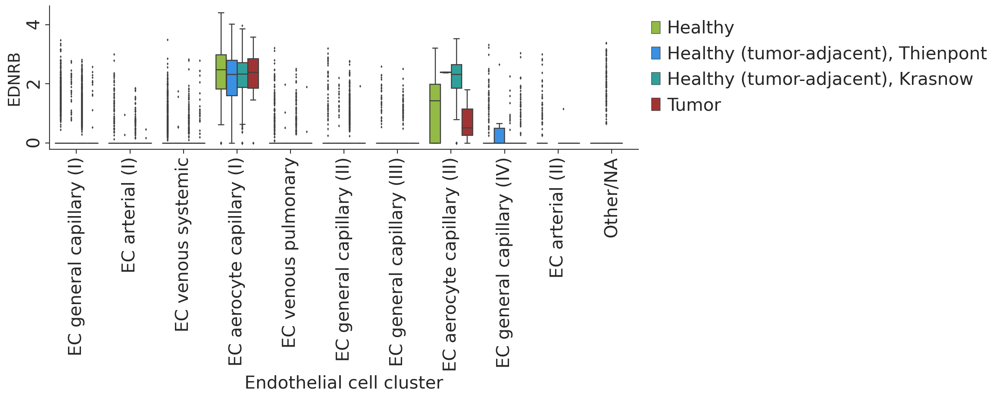

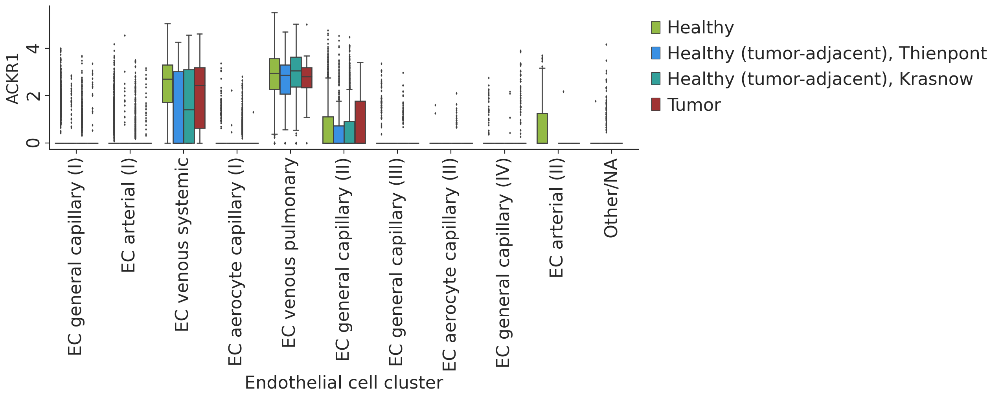

In [58]:
titles_per_gene = {
    #     "MT2A": "MT2A (putative normal EC marker)",
    "EDNRB": "EDNRB\n(putative normal\nEC marker)",  # this gene they validated with imm. fl.
    #     "HSPG2": "HSPG2 (putative tumor EC marker)",
    "ACKR1": "ACKR1\n(putative tumor\nEC marker)",  # this gene they validated with imm. fl.
    #     "SPRY1": "SPRY1 (putative tumor EC marker)",
}
fz = 20
with plt.rc_context(
    {
        "figure.figsize": (12, 3),
        "xtick.labelsize": fz,
        "ytick.labelsize": fz,
        "axes.labelsize": fz,
        "font.size": fz,
        "axes.spines.right": False,
        "axes.spines.top": False,
    }
):
    for gene in titles_per_gene.keys():
        gene_df = pd.DataFrame(
            subadata[:, gene].X.toarray(), index=subadata.obs.index, columns=[gene]
        )
        gene_df["EC_clusters"] = subadata.obs.EC_clusters
        gene_df["cancer"] = subadata.obs.cancer
        # order clusters alphabetically:
        gene_df.EC_clusters = gene_df.EC_clusters.cat.remove_unused_categories()
        gene_df.EC_clusters = gene_df.EC_clusters.cat.reorder_categories(
            new_categories=sorted(gene_df.EC_clusters.unique())
        )
        gene_df.EC_clusters = gene_df.EC_clusters.map(clusters_to_keep_mapper)
        fig, ax = plt.subplots()
        sns.boxplot(
            data=gene_df,
            x="EC_clusters",
            hue="cancer",
            y=gene,
            order=cl_cancer.index,
            #             ci="sd",  # None,
            fliersize=1,
            palette=colors,
            ax=ax,
        )  # ,c=["blue", "lightblue", "red", "grey"])
        ax.legend(loc=(1.01, 0.2), fontsize=fz, frameon=False)
        ax.tick_params(left=True, bottom=True, rotation=90)
        ax.set_xlabel("Endothelial cell cluster")
        ax.set_ylabel(gene, fontsize=fz - 2)
        #         ax.set_title(titles_per_gene[gene], fontsize=fz)
        plt.grid(False)
        plt.show()
        plt.close()
        FIGURES[f"ED_EC_tumor_marker_{gene}_expression"] = fig

subset to clusters with at least 10 tumor cells

In [59]:
min_n_tumor_cells = 10
cancer_count_per_cluster = (
    gene_df.groupby(["EC_clusters", "cancer"]).agg({"cancer": "count"}).unstack()
)
cancer_count_per_cluster.columns = cancer_count_per_cluster.columns.droplevel(0)
clusters_to_keep_cancer = cancer_count_per_cluster.index[
    cancer_count_per_cluster.Tumor > min_n_tumor_cells
].tolist()

In [60]:
clusters_to_keep_cancer

['EC general capillary (I)',
 'EC arterial (I)',
 'EC venous systemic',
 'EC aerocyte capillary (I)',
 'EC venous pulmonary',
 'EC general capillary (II)',
 'EC general capillary (IV)']

remove suffices where only one cluster of the cell type is left:

In [61]:
cl_to_filtclus_mapper = dict(zip(clusters_to_keep_cancer, clusters_to_keep_cancer))
cl_to_filtclus_mapper["EC aerocyte capillary (I)"] = "EC aerocyte capillary"
cl_to_filtclus_mapper["EC venous pulmonary (I)"] = "EC venous pulmonary"

if wanted: take only clusters in which marker expression median > 0:

In [62]:
# clusters_with_non_0_medians = [str(cl) for cl in [1, 3, 4, 5, 7, 9]]

In [63]:
# clusters_to_keep = [
#     cl for cl in clusters_to_keep_cancer if cl in clusters_with_non_0_medians
# ]

In [64]:
clusters_to_keep = clusters_to_keep_cancer

sort and rename rows:

In [65]:
cl_cancer_cltokeep = cl_cancer.loc[sorted(clusters_to_keep), :].copy()
cl_cancer_cltokeep.index = cl_cancer_cltokeep.index.map(cl_to_filtclus_mapper)

simplify columns (full version will be in supplement):

In [66]:
column_simplifier = {
    "Healthy": "Healthy",
    "Healthy (tumor-adjacent), Thienpont": "Healthy",
    "Healthy (tumor-adjacent), Krasnow": "Healthy",
    "Tumor": "Tumor",
}
cl_cancer_cltokeep.rename(columns=column_simplifier, inplace=True)
# add up healthy columns:
cl_cancer_cltokeep = cl_cancer_cltokeep.groupby(
    cl_cancer_cltokeep.columns, axis=1
).sum()

convert to percentages:

In [67]:
cl_cancer_cltokeep = (
    cl_cancer_cltokeep.divide(cl_cancer_cltokeep.sum(axis=1), axis=0) * 100
)

plot cancer proportion plots:

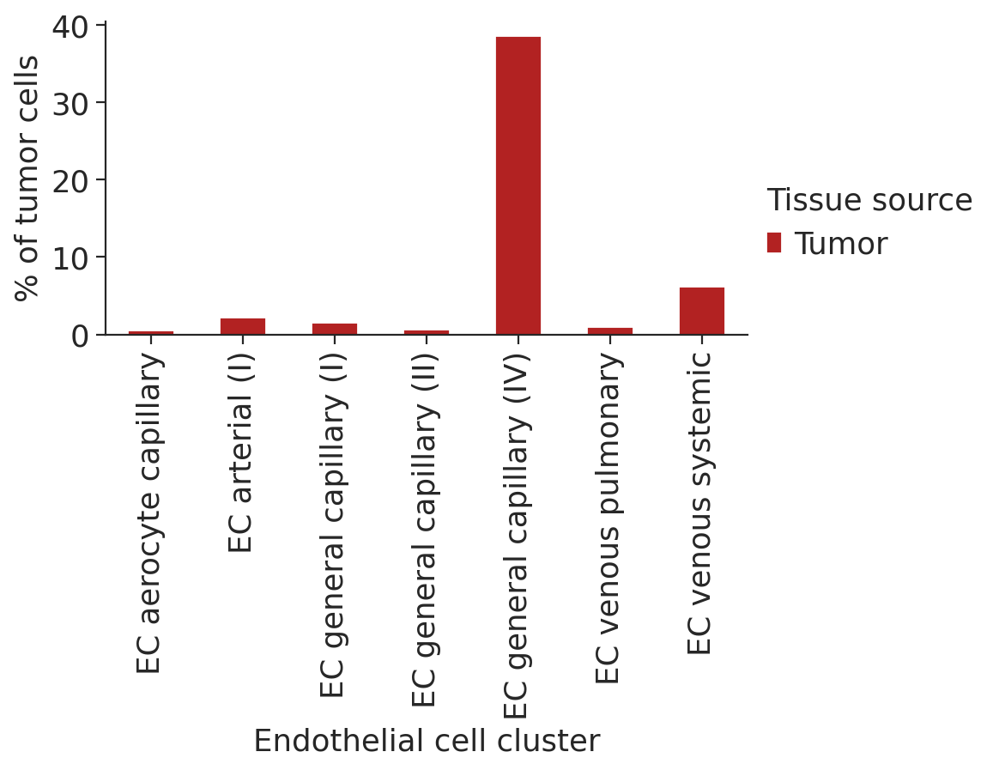

In [68]:
# l3_cancer = l3_cancer.div(l3_cancer.sum(axis=1), axis=0)
fz = 16
with plt.rc_context(
    {
        "figure.figsize": (6, 3),
        "xtick.labelsize": fz,
        "ytick.labelsize": fz,
        "axes.labelsize": fz,
        "font.size": fz,
        "axes.spines.right": False,
        "axes.spines.top": False,
    }
):
    fig, ax = plt.subplots(nrows=1, ncols=1)
    cl_cancer_cltokeep.loc[:, ["Tumor"]].plot(
        kind="bar",
        #         stacked=True,
        grid=False,
        color="firebrick",
        #         color=[colors[ttype] for ttype in cl_cancer.columns],
        ax=ax,
        edgecolor="white",  # "black",
    )
    ax.tick_params(bottom=True, left=True)
    handles, labels = ax.get_legend_handles_labels()
    leg = ax.legend(
        handles[::-1],
        labels[::-1],
        loc=(1.01, 0.2),
        fontsize=fz,
        frameon=False,
        title="Tissue source",
    )
    leg._legend_box.align = "left"
    leg.get_title().set_fontsize(fz)
    plt.ylabel("% of tumor cells")
    plt.xlabel("Endothelial cell cluster")
    plt.xticks(rotation=90)
    plt.show()
    plt.close()
    FIGURES[f"5c_EC_source_cancer_subset_of_clusters"] = fig

plot expression plots:

In [69]:
colors_simpl = {"Healthy": "dodgerblue", "Tumor": "firebrick"}

EDNRB (putative normal EC marker)


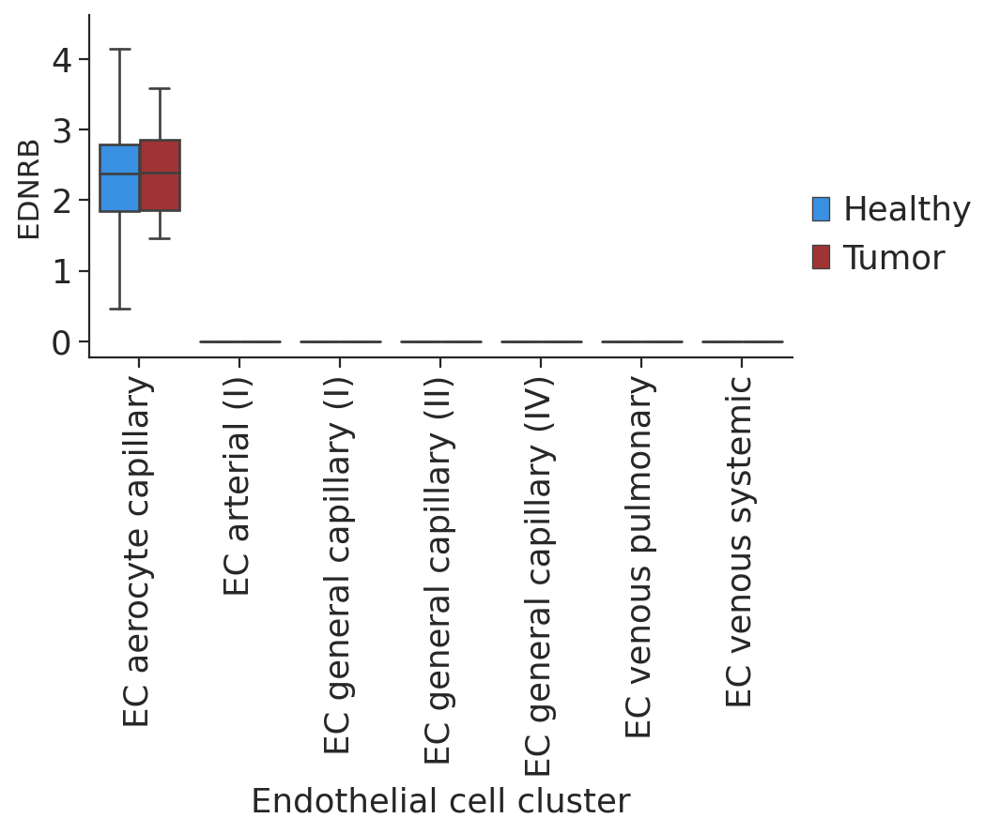

ACKR1 (putative tumor EC marker)


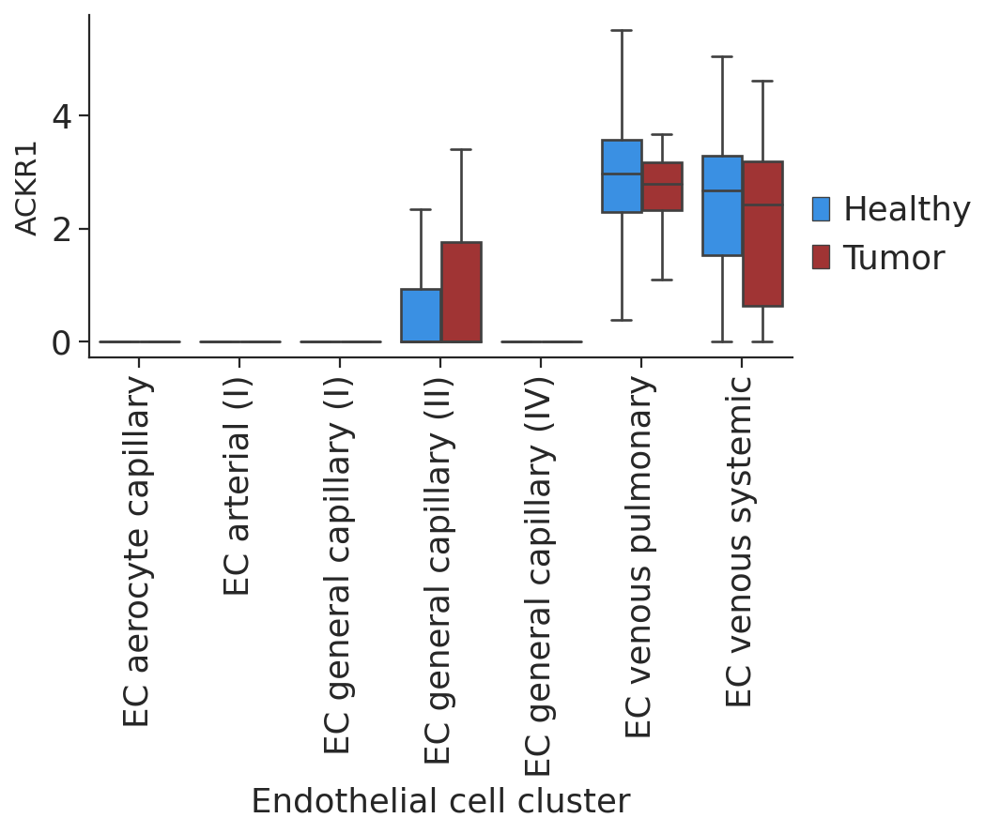

In [70]:
titles_per_gene = {
    #     "MT2A": "MT2A (putative normal EC marker)",
    "EDNRB": "EDNRB (putative normal EC marker)",  # this gene they validated with imm. fl.
    #     "HSPG2": "HSPG2 (putative tumor EC marker)",
    "ACKR1": "ACKR1 (putative tumor EC marker)",  # this gene they validated with imm. fl.
    #     "SPRY1": "SPRY1 (putative tumor EC marker)",
}
fz = 16
with plt.rc_context(
    {
        "figure.figsize": (6, 3),
        "xtick.labelsize": fz,
        "ytick.labelsize": fz,
        "axes.labelsize": fz,
        "font.size": fz,
        "axes.spines.right": False,
        "axes.spines.top": False,
    }
):
    for gene in titles_per_gene.keys():
        gene_df = pd.DataFrame(
            subadata[:, gene].X.toarray(), index=subadata.obs.index, columns=[gene]
        )
        gene_df["EC_clusters"] = subadata.obs.EC_clusters.map(clusters_to_keep_mapper)
        gene_df["cancer"] = subadata.obs.cancer.map(column_simplifier)
        # order clusters alphabetically:
        gene_df.EC_clusters = gene_df.EC_clusters.cat.reorder_categories(
            new_categories=sorted(gene_df.EC_clusters.unique())
        )
        # SUBSET TO CLUSTERS SELECTED ABOVE AND RENAME
        gene_df = gene_df.loc[gene_df.EC_clusters.isin(clusters_to_keep), :]
        gene_df.EC_clusters = gene_df.EC_clusters.map(cl_to_filtclus_mapper)

        fig, ax = plt.subplots()
        sns.boxplot(
            data=gene_df,
            x="EC_clusters",
            hue="cancer",
            y=gene,
            order=sorted(gene_df.EC_clusters.unique()),
            #             ci="sd",  # None,
            fliersize=0,
            palette=colors_simpl,
            ax=ax,
        )  # ,c=["blue", "lightblue", "red", "grey"])
        ax.legend(loc=(1.01, 0.2), fontsize=fz, frameon=False)
        ax.tick_params(left=True, bottom=True)
        ax.tick_params(axis="x", rotation=90)
        ax.set_xlabel("Endothelial cell cluster")
        print(titles_per_gene[gene])
        ax.set_ylabel(gene, fontsize=fz - 2)
        #         ax.set_title(titles_per_gene[gene], fontsize=fz)
        plt.grid(False)
        plt.show()
        plt.close()
        FIGURES[f"5c_tumor_marker_{gene}_expression_subset_of_clusters"] = fig

### store figures:

In [73]:
for figname, fig in FIGURES.items():
    print("Storing", figname)
    fig.savefig(
        os.path.join(dir_figures, f"{figname}.png"),
        bbox_inches="tight",
        dpi=140,
        transparent=True,
    )

Storing ED_thienpont_cancer_type
Storing ED_thienpont_subject_ID
Storing ED_thienpont_ref_annotations_coarse_umap
Storing ED_EC_cluster_manual_annotation
Storing ED_EC_tissue_source_cancer
Storing ED_EC_tumor_marker_EDNRB_expression
Storing ED_EC_tumor_marker_ACKR1_expression
Storing 5c_EC_source_cancer_subset_of_clusters
Storing 5c_tumor_marker_EDNRB_expression_subset_of_clusters
Storing 5c_tumor_marker_ACKR1_expression_subset_of_clusters
